<a href="https://colab.research.google.com/github/unburied/DS-Unit-2-Tree-Ensembles/blob/master/Copy_of_Pumps.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##Imports

In [1]:
%matplotlib inline
import matplotlib.pyplot as plt

In [2]:
!pip install pandas_profiling
!pip install category_encoders
!pip install plotly_express

In [3]:
import pandas as pd
import numpy as np

import category_encoders as ce
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

from sklearn.preprocessing import LabelEncoder
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.impute import SimpleImputer
from sklearn.decomposition import PCA

import plotly_express as px

In [4]:
def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
       <script src="/static/components/requirejs/require.js"></script>
       <script>
         requirejs.config({
           paths: {
             base: '/static/base',
             plotly: 'https://cdn.plot.ly/plotly-latest.min.js?noext',
           },
         });
       </script>
       '''))

In [5]:
!wget https://raw.githubusercontent.com/LambdaSchool/DS-Unit-2-Linear-Models/master/data/tanzania/train_features.csv
!wget https://raw.githubusercontent.com/LambdaSchool/DS-Unit-2-Linear-Models/master/data/tanzania/train_labels.csv
!wget https://raw.githubusercontent.com/LambdaSchool/DS-Unit-2-Linear-Models/master/data/tanzania/test_features.csv
!wget https://raw.githubusercontent.com/LambdaSchool/DS-Unit-2-Linear-Models/master/data/tanzania/sample_submission.csv

--2019-07-29 20:14:24--  https://raw.githubusercontent.com/LambdaSchool/DS-Unit-2-Linear-Models/master/data/tanzania/train_features.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.208.133
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.208.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 20054664 (19M) [text/plain]
Saving to: ‘train_features.csv.1’

train_features.csv. 100%[===================>]  19.12M  19.7MB/s    in 1.0s    

2019-07-29 20:14:25 (19.7 MB/s) - ‘train_features.csv.1’ saved [20054664/20054664]

--2019-07-29 20:14:25--  https://raw.githubusercontent.com/LambdaSchool/DS-Unit-2-Linear-Models/master/data/tanzania/train_labels.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.208.133
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.208.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1148327 (1.1M) [text

In [6]:
import pandas_profiling as pp

##Fetch

In [7]:
#load dataframes
X = pd.read_csv('train_features.csv')
Y = pd.read_csv('train_labels.csv')

#Drop id's
Y = Y.status_group

In [8]:
#pp.ProfileReport(X)

##Baseline

In [9]:
#Split data
X_train, X_val, y_train, y_val = train_test_split(X, Y,random_state = 42,stratify = Y)
    
#Baseline
y_train.value_counts(normalize = True)

functional                 0.543075
non functional             0.384242
functional needs repair    0.072682
Name: status_group, dtype: float64

In [10]:
#get nums from df
numericals = X.select_dtypes('number').columns.to_list()
print(numericals)

['id', 'amount_tsh', 'gps_height', 'longitude', 'latitude', 'num_private', 'region_code', 'district_code', 'population', 'construction_year']


In [11]:
model = LogisticRegression(solver = 'lbfgs', multi_class = 'auto', max_iter = 350)
model.fit(X_train[numericals],y_train)
model.score(X_val[numericals], y_val)

/home/unburied/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.



0.5498989898989899

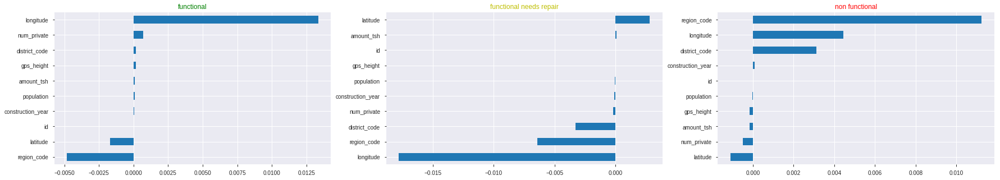

In [12]:
LogisticRegression(solver = 'lbfgs', multi_class = 'auto', max_iter = 350)
#plot coefficent values for each label
fig = plt.figure(figsize = (30,5))

ax = fig.add_subplot(131)
coeffs = pd.Series(model.coef_[0], numericals)
ax = coeffs.sort_values().plot.barh()
ax.set_title(model.classes_[0], color = 'g')

ax1 = fig.add_subplot(132)
coeffs = pd.Series(model.coef_[1], numericals)
ax1 = coeffs.sort_values().plot.barh()
ax1.set_title(model.classes_[1], color = 'y')

ax2 = fig.add_subplot(133)
coeffs = pd.Series(model.coef_[2], numericals)
ax2 = coeffs.sort_values().plot.barh()
ax2.set_title(model.classes_[2], color = 'r')

plt.show();

It looks like longitude and region code have some of the largest effects on the model based on the coefficients

##PreProcessing Functions


In [13]:
def get_elevations(x):
#store each region and gps height in dict
  elevations = {}
  for region in x.region.unique():
    elevations[region] = x[x.region == region]['gps_height'].median()

#These looks to be the problem areas. The median values for these regions should not be zeo
  zero_regions = ['Dodoma', 'Kagera', 'Mbeya', 'Mwanza', 'Shinyanga', 'Tabora']

#I looked up the elevations and imputed the data
  elevations['Dodoma'] = 1118
  elevations['Kagera'] = 1500
  elevations['Mbeya'] = 1700
  elevations['Mwanza'] = 1140
  elevations['Shinyanga'] = 1128
  elevations['Tabora'] = 1191

#Use new values to clean zeroes in df based on imputed values
  for key in elevations:
    if key in zero_regions:
      x.loc[x.region == key, 'gps_height'] = elevations[key]
  
  return x

In [14]:
def get_dates(x):
  #reassgin as datetime object
  x.date_recorded = pd.to_datetime(x.date_recorded,
                                   infer_datetime_format= True)
  
  #split values and add to df
  x['year_rec'] = x.date_recorded.dt.year
  x['age'] = x.year_rec - x.construction_year 
  
  #drop dates(not working with standard scaler?)
  x = x.drop('date_recorded', axis = 1)
  
  return x

In [15]:
#Impute population based on current data
def get_pops(x):  
  #These are HALF the current estimates for population
  region_pops = {'Dodoma' : 1050000, 'Kagera' : 1229000, 'Shinyanga': 767500,
                 'Mbeya' : 135000, 'Tabora': 113500, 'Mwanza' : 1350000}

  #Get means for regions using estimates and the std of the set for consistency
  for region,pop in region_pops.items():
    size = x.loc[x.region == region, 'population'].size
    mean =   pop / size
    std = x.population.std()

  #function will use Gaussian distribution to impute value at each location
    def pop_imputer(n):
      random = np.random.normal()
      impute = mean + (random * std) + n

      #Ensure value is not less than zero, if so rerun func
      if impute < 0:
        pop_imputer(n)
      else:
        return int(impute)

    x.loc[x.region == region, 'population'] = x.loc[x.region == region,
                                               'population'].apply(pop_imputer)

    #get slightly less granular population based on lga
    x['median_pop_at_lga'] = x.population

    for lga in x.lga.unique():
      x.loc[x.lga == lga ,'median_pop_at_lga'] = x[x.lga == lga]['population'].median()

  return x

In [16]:
def coordinates(x):
#eliminate null island values
  x['latitude'] = x['latitude'].replace(-2e-08, -2)

  #These locations contain ALL zero values for longitude
  locations = {'Magu' : 33.4444, 'Geita' : 32.2314, 'Bariadi' : 33.9833}
  
  for key,val in locations.items():
    x.loc[x.lga == key, 'longitude'] = val
  
  return x

In [17]:
def clean(df):
  x = df.copy()

#Clean zeroes in data
  if 'construction_year' in x.columns:
    x['construction_year'] = x.construction_year.replace(0, np.nan)
    x['construction_year'] = np.where(x.construction_year.isnull(),
                                   x.construction_year.mode(),
                                   x.construction_year)     
#reassign date values and impute elevation, population, and longitude data      
  if 'date_recorded' in x.columns:
    x = get_dates(x)
  if 'gps_height' in x.columns:
    x = get_elevations(x)
  if 'population' in x.columns:
    x = get_pops(x)
  if 'longitude' in x.columns:
    x = coordinates(x)

  #reassign bool values
  if 'permit' in x.columns:
    x['permit'] = np.where(x.permit == True , 1,0)
  if 'public_meeting' in x.columns:
    x['public_meeting'] = np.where(x.public_meeting == True , 1,0)

  #check for and replace unknowns and other with NAN
  for col in x.columns:
    if x[col].dtype == object:
      x[col] = np.where(x[col] == 'other', np.nan, x[col])
      x[col] = np.where(x[col] == 'unknown', np.nan, x[col])
  
  #drop items both high card and duplicates
    dropping = ['quantity_group', 'recorded_by','subvillage', 'wpt_name',
            'management_group']  
    if col in dropping:
      x = x.drop(columns = col)

  return x


In [18]:
#replcae categorical values and scale data
def encode_data(train, val): 
  #split object columns based on cardinality
  objs = train.select_dtypes('object').columns.tolist()
  hots = [col for col in objs if train[col].nunique() <= 10]
  ordins = [col for col in objs if train[col].nunique() > 10]
    
  #encode low card obj with onehotencoder
  ohe = ce.OneHotEncoder(use_cat_names=True, cols = hots, )
  train = ohe.fit_transform(train)
  val = ohe.transform(val)
  
  #encode high card obj with ordinal encoder
  enc = ce.OrdinalEncoder(return_df = True, cols = ordins, )
  train= enc.fit_transform(train)
  val = enc.transform(val)

  #Scale data
  scaled = StandardScaler()
  train_scale = scaled.fit_transform(train)
  val_scale = scaled.transform(val)
  
  #Ensure columns are maintained
  train = pd.DataFrame(train_scale, columns = train.columns)
  val = pd.DataFrame(val_scale, columns = val.columns)
  
  return train, val

In [19]:
def imputer(train, val):
  cols = train.columns.tolist()
  si = SimpleImputer()
  
  train = train.copy()
  val = val.copy()
  
  train = si.fit_transform(train)
  val = si.transform(val)
  
  train = pd.DataFrame(train, columns = cols)
  val = pd.DataFrame(val, columns = cols)
  
  return train, val

In [20]:
def split_data(X,Y):  
  #Split data
  X_train, X_val, y_train, y_val = train_test_split(X, Y,
                                              random_state = 42,stratify = Y)
  
  return [X_train, X_val, y_train, y_val]

In [45]:
def decompose(train,val):
  #perform pca on data
  pca = PCA(whiten = True)
  train = pca.fit_transform(train)
  val = pca.transform(val)
  
  return train, val

In [47]:
from sklearn.model_selection import KFold
#get predictions from various models and append to data
def add_model_pred(X,Y):
    #clean and copy data before adding features
    x = X.copy()
    x, _ = pipeline(x, test = x, encode = True, impute = True, pca = True)
    
    #Use K-fold cross-validation to prevent leakage
    kf = KFold(5)

    #instantiate disctionaries containing models and list to store predictions
    predictions = {'rfc' : [], 'gbm': [], 'knn': []} 
    models = {'rfc':RandomForestClassifier(n_estimators= 150, n_jobs= -1, max_depth = 10),
              'gbm':GradientBoostingClassifier(n_estimators= 150, max_depth = 2),
              'knn':KNeighborsClassifier(n_neighbors = 4, leaf_size = 25, n_jobs = -1)}

    #split and store for usage in model
    for train, test in kf.split(x):
        X_train, X_test = x[train], x[test]
        y_train  = Y[train]

        #for each fold, train model and add predictions to list
        for name,model in models.items():
            model.fit(X_train, y_train)
            y_pred = model.predict(X_test)
            predictions[name].extend(y_pred)

    #append predictions to passed df as features
    for key,val in predictions.items():
        X[key] = val
    
    return X

In [23]:
#Pipeline to encode, scale, split 
def pipeline(X, y = None, encode = False, impute = False,
             test = None, pca = False):
  
  target_supplied = False
  test_transformation_requested = False
  
  #preprocess data 
  x = clean(X) 
  
  #Check that a y vector is passed to perform operations in conjunction with it
  if type(y) == pd.Series:
    target_supplied = True
    
  #load and clean test data if included(for submission purposes) 
  if type(test) == pd.DataFrame:
    test = test = clean(test)
    test_transformation_requested = True  
    
  #performm train test split on data if y vector supplied
  if target_supplied:
    data = split_data(x,y) 
    
  #encode categorical data
  if encode and target_supplied:
    data[0], data[1] = encode_data(data[0], data[1])  
  if encode and test_transformation_requested:
    x, test = encode_data(x, test)  
    
  #implement simple imputer
  if impute and target_supplied:
    data[0], data[1] = imputer(data[0], data[1])
  if impute and test_transformation_requested:
    x, test = imputer(x, test)       
    
  #perform pca decomposition  
  if pca and target_supplied:
    data[0], data[1] = decompose(data[0], data[1])
  if pca and test_transformation_requested:
    x, test = decompose(x, test)
  
  if target_supplied:
    return data
  elif test_transformation_requested:
    return x, test

##Preliminary Models

In [41]:
#test and score each model
def model_score(model, data):
  X_train = data[0] 
  X_val = data[1]
  y_train = data[2]
  y_val = data[3]
  
  model.fit(X_train,y_train)
  y_pred = model.predict(X_val)
  
  return accuracy_score(y_val, y_pred)

In [25]:
#run dfs through pipeline
#data = pipeline(X, y = Y ,encode = True, impute = True)

In [26]:
#instantiate models
#dt = DecisionTreeClassifier()
#gbm = GradientBoostingClassifier()
#knn = KNeighborsClassifier()
#rf = RandomForestClassifier(n_estimators= 150)

#get and print scores
#print(f'Tree - {model_score(dt, data)}')
#print(f'Boost - {model_score(gbm, data)}')
#print(f'Neighbor - {model_score(knn, data)}')
#print(f'Forest - {model_score(rf, data)}')

Its looks like Random Forest will give us a good score right from the start. 

##Feature Exploration

In [27]:
fig = plt.figure(figsize = (7,7))

#importance = pd.Series(rf.feature_importances_, data[0].columns)
#importance.sort_values(ascending = True)[86:].plot.barh();

<Figure size 504x504 with 0 Axes>

In [28]:
fe = clean(X.copy())
fe = fe.join(Y)
fe = fe.fillna(method ='ffill')

In [29]:
configure_plotly_browser_state()

In [30]:
px.scatter(fe, x = 'longitude',y= 'latitude', color = 'quantity', 
            size = 'population', facet_col = 'status_group',
           title = 'Quantity, Population, and Functionality')

In [31]:
fe.quantity.value_counts()

enough          33615
insufficient    15370
dry              6320
seasonal         4095
Name: quantity, dtype: int64

In [32]:
px.scatter(fe, x = 'longitude',y= 'latitude', color = 'extraction_type_class', 
           size = 'population' , facet_col = 'status_group',
           title = 'Extraction Type, Population, and Functionality', )

In [33]:
fe.extraction_type_class.value_counts()

gravity         30021
handpump        18515
submersible      6932
motorpump        3301
rope pump         507
wind-powered      124
Name: extraction_type_class, dtype: int64

In [34]:
px.scatter(fe, x = 'longitude',y= 'latitude', color = 'waterpoint_type_group', 
           size = 'population',  facet_col = 'status_group',
           title = 'Waterpoint Type, Population, and Functionality', )

In [35]:
fe.waterpoint_type_group.value_counts()

communal standpipe    38749
hand pump             19624
improved spring         889
cattle trough           131
dam                       7
Name: waterpoint_type_group, dtype: int64

In [36]:
px.scatter(fe, x = 'longitude',y= 'latitude', color = 'gps_height', 
           facet_col = 'status_group',
           title = 'Elevation and Functionality', )

In [37]:
fe.quality_group.value_counts()

good        52483
salty        5370
milky         822
colored       505
fluoride      220
Name: quality_group, dtype: int64

##Feature Selection

I selected a subset of features based on reported and percieved importance.  It appears choosing a subset did not boost the model performance. My assumption was that reducing the noise would increase accuracy. 

In [38]:
features = ['waterpoint_type_group', 'extraction_type_class', 'quantity',
            'latitude', 'longitude', 'gps_height', 'region', 'population',
            'lga', 'construction_year', 'date_recorded']
columns = ['quantity_seasonal','waterpoint_type_group_cattle trough',
           'waterpoint_type_group_dam', 'extraction_type_class_wind-powered']

x = X.copy()
#data = pipeline(x[features], y = Y, encode = True, impute = True)

#data[0] = data[0].drop(columns = columns)
#data[1] = data[1].drop(columns = columns)         

#rf = RandomForestClassifier(n_estimators=150, n_jobs = -1)
#model_score(rf, data)

In [39]:
fig = plt.figure(figsize = (7,7))

#importance = pd.Series(rf.feature_importances_, data[0].columns)
#importance.sort_values(ascending = True).plot.barh();

<Figure size 504x504 with 0 Axes>

##Feature Engineering 

In [48]:
#add model predictions as features
X = add_model_pred(X,Y)

/home/unburied/anaconda3/lib/python3.7/site-packages/sklearn/preprocessing/data.py:645: DataConversionWarning:

Data with input dtype int64, float64 were all converted to float64 by StandardScaler.

/home/unburied/anaconda3/lib/python3.7/site-packages/sklearn/base.py:464: DataConversionWarning:

Data with input dtype int64, float64 were all converted to float64 by StandardScaler.

/home/unburied/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:21: DataConversionWarning:

Data with input dtype int64, float64 were all converted to float64 by StandardScaler.



In [49]:
X.head()

,id,amount_tsh,date_recorded,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,...,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,rfc,gbm,knn
0,69572,6000.0,2011-03-14,Roman,1390,Roman,34.938093,-9.856322,none,0,...,enough,enough,spring,spring,groundwater,communal standpipe,communal standpipe,functional,functional,functional
1,8776,0.0,2013-03-06,Grumeti,1399,GRUMETI,34.698766,-2.147466,Zahanati,0,...,insufficient,insufficient,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe,functional,functional,functional
2,34310,25.0,2013-02-25,Lottery Club,686,World vision,37.460664,-3.821329,Kwa Mahundi,0,...,enough,enough,dam,dam,surface,communal standpipe multiple,communal standpipe,functional,functional,functional
3,67743,0.0,2013-01-28,Unicef,263,UNICEF,38.486161,-11.155298,Zahanati Ya Nanyumbu,0,...,dry,dry,machine dbh,borehole,groundwater,communal standpipe multiple,communal standpipe,non functional,non functional,functional
4,19728,0.0,2011-07-13,Action In A,0,Artisan,31.130847,-1.825359,Shuleni,0,...,seasonal,seasonal,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe,functional,functional,functional


In [51]:
data = pipeline(X, y = Y, encode = True, impute = True, pca = True)

/home/unburied/anaconda3/lib/python3.7/site-packages/sklearn/preprocessing/data.py:645: DataConversionWarning:

Data with input dtype int64, float64 were all converted to float64 by StandardScaler.

/home/unburied/anaconda3/lib/python3.7/site-packages/sklearn/base.py:464: DataConversionWarning:

Data with input dtype int64, float64 were all converted to float64 by StandardScaler.

/home/unburied/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:21: DataConversionWarning:

Data with input dtype int64, float64 were all converted to float64 by StandardScaler.



In [ ]:
X.head()

In [55]:
rf = RandomForestClassifier(n_estimators= 220, n_jobs= -1)
gbm = GradientBoostingClassifier(n_estimators = 300)
knn = KNeighborsClassifier(n_neighbors = 6, leaf_size = 30, n_jobs = -1)
lr = LogisticRegression(solver = 'lbfgs', multi_class = 'auto', max_iter = 350)

#get and print scores
print(f'Forest - {model_score(lr, data)}')
print(f'Boost - {model_score(gbm, data)}')
print(f'Neighbor - {model_score(knn, data)}')
print(f'Forest - {model_score(rf, data)}')

Forest - 0.4232996632996633
Boost - 0.781010101010101
Neighbor - 0.7248484848484849
Forest - 0.7738047138047138


In [ ]:
print(f'Forest - {model_score(lr, data)}')

In [ ]:
#plot coefficent values for each label
fig = plt.figure(figsize = (30,5))

ax = fig.add_subplot(131)
coeffs = pd.Series(lr.coef_[0], data[0].columns)
ax = coeffs.sort_values()[113:].plot.barh()
ax.set_title(model.classes_[0], color = 'g')

ax1 = fig.add_subplot(132)
coeffs = pd.Series(lr.coef_[1], data[0].columns)
ax1 = coeffs.sort_values()[113:].plot.barh()
ax1.set_title(model.classes_[1], color = 'y')

ax2 = fig.add_subplot(133)
coeffs = pd.Series(lr.coef_[2], data[0].columns)
ax2 = coeffs.sort_values()[113:].plot.barh()
ax2.set_title(model.classes_[2], color = 'r')

plt.show();

In [ ]:
fig = plt.figure(figsize = (7,7))

importance = pd.Series(rf.feature_importances_, data[0].columns)
importance.sort_values(ascending = True)[86:].plot.barh();

##HyperTuning


In [57]:
from sklearn.model_selection import RandomizedSearchCV

#number of trees
n_estimators = [1, 2, 4, 8, 16, 32, 64, 100, 200]

#number of features
max_features = [ 2, 4, 8, 16, 32]

#number of levels
max_depth = [int(x) for x in np.linspace(1, 34, num = 5)]
max_depth.append(None)

#min samples for split at node
min_samples_split = np.linspace(0.1, 1.0, 10, endpoint=True)

#min samples at each leaf
min_samples_leaf = np.linspace(0.1, 0.5, 5, endpoint=True)

#Shrinks contribution of each tree
learning_rate = [1, 0.5, 0.25, 0.1, 0.05, 0.01]
#create grid
random_grid = {'n_estimators' : n_estimators,
               'max_features' : max_features,
               'max_depth' : max_depth,
               'min_samples_split' : min_samples_split,
               'min_samples_leaf' : min_samples_leaf,
               'learning_rate' : learning_rate}                                                   

In [61]:
#Instantiate model to tune
gb_tune = GradientBoostingClassifier()

#pass model to tune along with grid of parameters
#iterate 100 times with 3 fold cross validation
gb_random = RandomizedSearchCV(estimator =gb_tune, param_distributions= random_grid,
                               n_iter = 50, cv = 3, verbose = 2, 
                               random_state = 42, n_jobs = 3)

#fit tuner
#data[0] == X_train
#data[2] == y_train
gb_random.fit(data[0], data[2])

Fitting 3 folds for each of 50 candidates, totalling 150 fits


[Parallel(n_jobs=3)]: Using backend LokyBackend with 3 concurrent workers.
/home/unburied/anaconda3/lib/python3.7/site-packages/sklearn/externals/joblib/externals/loky/process_executor.py:706: UserWarning:

A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.

/home/unburied/anaconda3/lib/python3.7/site-packages/sklearn/externals/joblib/externals/loky/process_executor.py:706: UserWarning:

A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.

/home/unburied/anaconda3/lib/python3.7/site-packages/sklearn/externals/joblib/externals/loky/process_executor.py:706: UserWarning:

A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.

[Parallel(n_jobs=3)]: Done  35 tasks      | elapsed:   52.5s
/home/unburied/anaconda3/lib/python3.7/site-packages/sklearn/externals/j

RandomizedSearchCV(cv=3, error_score='raise-deprecating',
          estimator=GradientBoostingClassifier(criterion='friedman_mse', init=None,
              learning_rate=0.1, loss='deviance', max_depth=3,
              max_features=None, max_leaf_nodes=None,
              min_impurity_decrease=0.0, min_impurity_split=None,
              min_samples_leaf=1, min_sampl...      subsample=1.0, tol=0.0001, validation_fraction=0.1,
              verbose=0, warm_start=False),
          fit_params=None, iid='warn', n_iter=50, n_jobs=3,
          param_distributions={'n_estimators': [1, 2, 4, 8, 16, 32, 64, 100, 200], 'max_features': [2, 4, 8, 16, 32], 'max_depth': [1, 9, 17, 25, 34, None], 'min_samples_split': array([0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]), 'min_samples_leaf': array([0.1, 0.2, 0.3, 0.4, 0.5]), 'learning_rate': [1, 0.5, 0.25, 0.1, 0.05, 0.01]},
          pre_dispatch='2*n_jobs', random_state=42, refit=True,
          return_train_score='warn', scoring=None, verbose=2)

In [62]:
gb_random.best_params_

{'n_estimators': 200,
 'min_samples_split': 0.1,
 'min_samples_leaf': 0.1,
 'max_features': 8,
 'max_depth': None,
 'learning_rate': 0.5}

In [63]:
best_random = gb_random.best_estimator_

In [65]:
y_pred = best_random.predict(data[1])
accuracy_score(data[3], y_pred)

0.7736700336700336

##Submission


In [66]:
#fetch test data for submission
test = pd.read_csv('test_features.csv')
sample_submission = pd.read_csv('sample_submission.csv')

In [67]:
test = add_model_pred(test, Y)

/home/unburied/anaconda3/lib/python3.7/site-packages/sklearn/preprocessing/data.py:645: DataConversionWarning:

Data with input dtype int64, float64 were all converted to float64 by StandardScaler.

/home/unburied/anaconda3/lib/python3.7/site-packages/sklearn/base.py:464: DataConversionWarning:

Data with input dtype int64, float64 were all converted to float64 by StandardScaler.

/home/unburied/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:21: DataConversionWarning:

Data with input dtype int64, float64 were all converted to float64 by StandardScaler.



In [ ]:
test.shape

In [ ]:
X.shape

In [69]:
X, test = pipeline(X, test = test, encode = True, impute = True, pca = True)

/home/unburied/anaconda3/lib/python3.7/site-packages/sklearn/preprocessing/data.py:645: DataConversionWarning:

Data with input dtype int64, float64 were all converted to float64 by StandardScaler.

/home/unburied/anaconda3/lib/python3.7/site-packages/sklearn/base.py:464: DataConversionWarning:

Data with input dtype int64, float64 were all converted to float64 by StandardScaler.

/home/unburied/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:21: DataConversionWarning:

Data with input dtype int64, float64 were all converted to float64 by StandardScaler.



In [71]:
boost = GradientBoostingClassifier(n_estimators = 200,
 min_samples_split = 0.1,
 min_samples_leaf = 0.1,
 max_features = 8,
 max_depth = None,
 learning_rate = 0.5)

boost.fit(X, Y)
y_pred = boost.predict(test)

In [78]:
#from google.colab import files

submission = sample_submission.copy()
submission['status_group'] = y_pred


from IPython.display import HTML
import base64 

def create_download_link( data, title = "Submission", filename = "submission-05.csv'"):  
    csv = data.to_csv()
    b64 = base64.b64encode(csv.encode())
    payload = b64.decode()
    html = '<a download="{filename}" href="data:text/csv;base64,{payload}" target="_blank">{title}</a>'
    html = html.format(payload=payload,title=title,filename=filename)
    return HTML(html)

create_download_link(submission)